# **Water Management and Forecasting**
### **Project Backgroung**
The arid climate of several Algerian regions and the water-stressed region of Bhopal, effective water management and forecasting are crucial. This project aims to harness the power of machine learning to address the unique water resource challenges faced by both regions. By creating an open-source solution, we aim to empower Algeria and Bhopal to make informed decisions, optimize resource allocation, and build resilient water infrastructure for a sustainable future.
### **Project Goals**
**Develop a Comprehensive Open-Source Water Management and Forecasting System:** Create a user-friendly platform tailored to the specific needs of Algeria and Bhopal, integrating machine learning algorithms for precise water forecasting and efficient water resource management.

- **Enhance Water Resource Utilization:** Improve the sustainable use of water resources in both regions by providing accurate forecasts and real-time monitoring.
- **Capacity Building:** Empower local stakeholders in Algeria and Bhopal with the knowledge and tools necessary to make well-informed decisions about water management.
- **Community Engagement:** Foster collaboration among local government agencies, NGOs, and the research community to collectively address water-related challenges in both regions.

**Data Source:**</BR>
* https://developers.google.com/earth-engine/datasets/catalog/NOAA_GFS0P25
* https://developers.google.com/earth-engine/datasets/catalog/NASA_GLDAS_V022_CLSM_G025_DA1D

# **Import Modules**

In [1]:
#### Import the libraries needed
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
from pathlib import Path
import os
import glob

import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from statsmodels.tsa.stattools import adfuller, grangercausalitytests
import statsmodels.api as sm

import warnings
from statsmodels.tools.sm_exceptions import ConvergenceWarning
warnings.simplefilter('ignore', ConvergenceWarning)
warnings.filterwarnings('ignore')
%matplotlib notebook
%matplotlib inline

# **Set Environment**

In [2]:
import plotly.io as pio
pio.renderers.default = "vscode"

In [18]:
# Set up directory
working_directory = Path.cwd()
parent = working_directory.parents[2]
# data directory
processed_data_directory = parent / 'src' / 'data' / 'processed'

In [4]:
# Set pd.options to add slide bars
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 100)

In [5]:
# Set default title color
plt.style.use('fivethirtyeight')

# set default plt figure size
plt.rcParams["figure.figsize"] = [10, 5]
# suptitle
plt.rcParams["figure.titlesize"] = 22
plt.rcParams["figure.titleweight"] = "bold"
plt.rcParams['text.color'] = '#333333'
# title
plt.rcParams["axes.titlesize"] = 16
plt.rcParams["axes.titleweight"] = "bold"
plt.rcParams["axes.titlelocation"] = "left"
plt.rcParams['axes.titlecolor'] = '#333333'
# label
plt.rcParams["axes.labelsize"] = 12
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['axes.labelcolor'] = '#333333'
# spines
plt.rcParams["axes.spines.bottom"] = True
plt.rcParams["axes.spines.left"] = True
plt.rcParams["axes.spines.top"] = False
plt.rcParams["axes.spines.right"] = False
# tick
plt.rcParams['xtick.color'] = "#333333"
plt.rcParams['ytick.color'] = "#333333"

# **Load data**

* GFS datasets from 2015 to 2023 were merged into GFS_Bhopal_2015_2023.csv
* GLDAS_Bhopal_2010_2023.csv and GFS_Bhopal_2015_2023.csv were merged into GLDAS_GFS_Bhopal_2015_2023.csv
* The dataset contains 2980 data points and 32 features from 2015 Apr 1 through 2023 June 30 
* No null values
* No duplicates
* The datasets contain 31 numerical features and 1 datetime column

### **Feature Names and Description**
* Plant Canopy Surface Water: This is crucial in understanding the interception of precipitation by vegetation, which affects the amount of water reaching the ground and available for infiltration into the soil.
* Groundwater Storage: This is vital in areas that rely on groundwater for drinking water supply or irrigation. Understanding groundwater storage can help manage water extraction sustainably.
* Baseflow-Groundwater Runoff: This is important for maintaining streamflow in periods without rain, which is essential for aquatic ecosystems and water supply systems that depend on surface water.
* Terrestrial Water Storage: This encompasses all forms of water storage on land (including all the above) and is key to understanding the overall water availability in a region.
* Profile soil moisture is the water content of the soil in different layers, from the surface to the depth of the soil. It is an important factor for understanding the hydrological cycle and the availability of water for plants and animals.
* **ACond_tavg**: 	Aerodynamic conductance
* **AvgSurfT_tavg**: 	Average surface skin temperature
* **CanopInt_tavg**: 	Plant canopy surface water
* **ECanop_tavg**: 	Canopy water evaporation
* **ESoil_tavg**: 	Direct evaporation from bare soil
* **EvapSnow_tavg**: 	Snow Evaporation                <-- All 0, Check
* **Evap_tavg**: 	Evapotranspiration                  <-- Small values, Check
* **GWS_tavg**: 	Ground water storage
* **Lwnet_tavg**: 	Net long-wave radiation flux
* **Qg_tavg**: 	Heat flux
* **Qh_tavg**: 	Sensible heat net flux
* **Qle_tavg**: 	Latent heat net flux
* **Qsb_tavg**: 	Baseflow-groundwater runoff         <-- All 0, Check
* **Qsm_tavg**: 	Snow melt                           <-- All 0, Check
* **Qs_tavg**: 	Storm surface runoff                    <-- Small values, Check
* **SnowDepth_tavg**: 	Snow depth                      <-- All 0, Check
* **SnowT_tavg**: 	Snow Surface temperature
* **SoilMoist_P_tavg**: 	Profile Soil moisture
* **SoilMoist_RZ_tavg**: 	Root Zone Soil moisture
* **SoilMoist_S_tavg**: 	Surface Soil moisture
* **SWE_tavg**: 	Snow depth water equivalent         <-- All 0, Check
* **Swnet_tavg**: 	Net short wave radiation flux
* **TVeg_tavg**: 	Transpiration                       <-- Small values, Check
* **TWS_tavg**: 	Terrestrial water storage

* **temperature_2m_above_ground**: Temperature 2m above ground
* **specific_humidity_2m_above_ground**: Specific humidity 2m above ground
* **relative_humidity_2m_above_ground**: Relative humidity 2m above ground
* **u_component_of_wind_10m_above_ground**: U component of wind 10m above ground
* **v_component_of_wind_10m_above_ground**: V component of wind 10m above ground
* **total_precipitation_surface**: Cumulative precipitation at surface for the previous 1-6 hours, depending on the value of the "forecast_hours" property according to the formula ((F - 1) % 6) + 1 (and only for assets with forecast_hours > 0)
* **precipitable_water_entire_atmosphere**: Precipitable water for entire atmosphere
* **total_cloud_cover_entire_atmosphere**: Total cloud cover for entire atmosphere (only for assets with forecast_hours > 0)
* **downward_shortwave_radiation_flux**: Downward shortwave radiation flux (only for assets with forecast_hours > 0)



In [20]:
file = os.path.join(processed_data_directory, "GLDAS_GFS_Bhopal_2015_2023.csv")
df = pd.read_csv(file, parse_dates=['date'])
df.sort_values('date', inplace=True)
df.head()

,date,temperature_2m_above_ground,specific_humidity_2m_above_ground,relative_humidity_2m_above_ground,u_component_of_wind_10m_above_ground,v_component_of_wind_10m_above_ground,precipitable_water_entire_atmosphere,total_precipitation_surface,ACond_tavg,AvgSurfT_tavg,CanopInt_tavg,ECanop_tavg,ESoil_tavg,EvapSnow_tavg,Evap_tavg,GWS_tavg,Lwnet_tavg,Qg_tavg,Qh_tavg,Qle_tavg,Qsb_tavg,Qsm_tavg,Qs_tavg,SnowDepth_tavg,SnowT_tavg,SoilMoist_P_tavg,SoilMoist_RZ_tavg,SoilMoist_S_tavg,SWE_tavg,Swnet_tavg,TVeg_tavg,TWS_tavg
0,2015-04-01,31.381519,0.005640,19.084161,4.671449,-0.277626,19.053919,0.0,0.009535,301.828791,0.000085,6.492022e-10,0.000028,0.0,0.000029,878.020093,-90.396704,5.002746,57.287802,70.673777,0.0,0.0,0.000000e+00,0.0,301.828791,1153.966420,275.946408,4.782809,0.0,223.362352,6.349899e-07,1153.966582
1,2015-04-02,31.612318,0.006702,22.664057,5.663895,-0.951907,19.920647,0.0,0.011490,302.765242,0.000052,2.799420e-10,0.000028,0.0,0.000028,877.131936,-81.731904,9.743703,60.882683,69.560302,0.0,0.0,0.000000e+00,0.0,302.765242,1151.749923,274.617967,4.659694,0.0,221.923497,4.469356e-07,1151.749969
2,2015-04-03,30.854070,0.006804,23.969701,5.704286,-0.857162,19.664423,0.0,0.012793,303.068777,0.000037,1.457972e-10,0.000026,0.0,0.000027,876.220241,-80.587193,6.332965,65.454717,65.798244,0.0,0.0,0.000000e+00,0.0,303.068777,1149.649158,273.428841,4.484641,0.0,218.171090,3.210499e-07,1149.649124
3,2015-04-04,30.046127,0.008165,30.080859,2.575579,-1.547093,24.770628,0.0,0.014474,302.893081,0.000027,8.663470e-11,0.000021,0.0,0.000022,875.300761,-72.375750,7.162284,84.828026,53.421145,0.0,0.0,0.000000e+00,0.0,302.893081,1147.826225,272.525414,4.354961,0.0,217.789598,2.082960e-07,1147.826188
4,2015-04-05,30.523074,0.007366,26.557658,-0.549178,-0.442961,23.765168,0.0,0.010641,302.875925,0.000883,2.446408e-07,0.000019,0.0,0.000019,874.372780,-56.206076,6.185620,66.643473,46.833714,0.0,0.0,1.183570e-09,0.0,302.875925,1146.413800,272.040991,4.340641,0.0,175.870913,1.475418e-07,1146.414677


In [9]:
df.tail()

,date,temperature_2m_above_ground,specific_humidity_2m_above_ground,relative_humidity_2m_above_ground,u_component_of_wind_10m_above_ground,v_component_of_wind_10m_above_ground,precipitable_water_entire_atmosphere,total_precipitation_surface,ACond_tavg,AvgSurfT_tavg,CanopInt_tavg,ECanop_tavg,ESoil_tavg,EvapSnow_tavg,Evap_tavg,GWS_tavg,Lwnet_tavg,Qg_tavg,Qh_tavg,Qle_tavg,Qsb_tavg,Qsm_tavg,Qs_tavg,SnowDepth_tavg,SnowT_tavg,SoilMoist_P_tavg,SoilMoist_RZ_tavg,SoilMoist_S_tavg,SWE_tavg,Swnet_tavg,TVeg_tavg,TWS_tavg
2975,2023-06-26,26.304192,0.017500,78.489295,4.621689,1.241421,59.124345,3.681857,0.014880,301.319386,0.010942,0.000002,0.000024,0.0,0.000028,821.132273,-3.098705,-10.344487,42.815345,68.294639,0.0,0.0,0.000004,0.0,301.319386,1119.148058,298.015849,6.533273,0.0,103.863962,0.000002,1119.159069
2976,2023-06-27,26.609251,0.017689,78.081354,4.565200,1.555393,58.825112,3.636627,0.016214,301.113478,0.010765,0.000002,0.000026,0.0,0.000030,822.014210,0.347042,-7.623907,34.966429,74.206189,0.0,0.0,0.000018,0.0,301.113478,1123.364814,301.350545,6.898181,0.0,101.200953,0.000002,1123.375532
2977,2023-06-28,26.892660,0.017768,76.791421,4.170625,1.146734,60.177433,1.603568,0.016272,300.568071,0.012465,0.000002,0.000031,0.0,0.000037,823.678898,4.282264,-8.339805,31.559352,90.448594,0.0,0.0,0.000053,0.0,300.568071,1134.990114,311.311238,7.512892,0.0,109.385402,0.000003,1135.002598
2978,2023-06-29,27.319106,0.018360,77.157611,3.962298,0.360457,62.622001,1.988386,0.017152,300.438963,0.012693,0.000002,0.000028,0.0,0.000034,826.473011,4.832132,-6.900661,38.382987,84.663859,0.0,0.0,0.000030,0.0,300.438963,1144.042161,317.569183,7.319170,0.0,111.313468,0.000004,1144.054883
2979,2023-06-30,27.389405,0.018356,76.932610,3.849981,-0.129736,62.947182,2.391717,0.016794,300.249694,0.013172,0.000002,0.000025,0.0,0.000032,829.937107,1.440541,-5.905571,30.057209,79.849653,0.0,0.0,0.000008,0.0,300.249694,1151.335034,321.397936,7.022767,0.0,102.562258,0.000005,1151.348196


In [10]:
print("Shape: ", df.shape)

Shape:  (2980, 32)


In [21]:
# Print date range
print("Data range: ", df['date'].min(), df['date'].max())

Data range:  2015-04-01 00:00:00 2023-06-30 00:00:00


In [22]:
# Check columns
num_cols = df.select_dtypes(include=[np.number]).columns
print(f"Numerical Columns: {num_cols}")
print()

cat_cols = df.select_dtypes(exclude=[np.number]).columns
print(f"Categorical Columns: {cat_cols}")

Numerical Columns: Index(['temperature_2m_above_ground', 'specific_humidity_2m_above_ground',
       'relative_humidity_2m_above_ground',
       'u_component_of_wind_10m_above_ground',
       'v_component_of_wind_10m_above_ground',
       'precipitable_water_entire_atmosphere', 'total_precipitation_surface',
       'ACond_tavg', 'AvgSurfT_tavg', 'CanopInt_tavg', 'ECanop_tavg',
       'ESoil_tavg', 'EvapSnow_tavg', 'Evap_tavg', 'GWS_tavg', 'Lwnet_tavg',
       'Qg_tavg', 'Qh_tavg', 'Qle_tavg', 'Qsb_tavg', 'Qsm_tavg', 'Qs_tavg',
       'SnowDepth_tavg', 'SnowT_tavg', 'SoilMoist_P_tavg', 'SoilMoist_RZ_tavg',
       'SoilMoist_S_tavg', 'SWE_tavg', 'Swnet_tavg', 'TVeg_tavg', 'TWS_tavg'],
      dtype='object')

Categorical Columns: Index(['date'], dtype='object')


In [23]:
# Check null
print("Number of null", df.isna().sum())

# Check duplicates
print("Number of duplictes", df.duplicated().sum())

Number of null date                                    0
temperature_2m_above_ground             0
specific_humidity_2m_above_ground       0
relative_humidity_2m_above_ground       0
u_component_of_wind_10m_above_ground    0
v_component_of_wind_10m_above_ground    0
precipitable_water_entire_atmosphere    0
total_precipitation_surface             0
ACond_tavg                              0
AvgSurfT_tavg                           0
CanopInt_tavg                           0
ECanop_tavg                             0
ESoil_tavg                              0
EvapSnow_tavg                           0
Evap_tavg                               0
GWS_tavg                                0
Lwnet_tavg                              0
Qg_tavg                                 0
Qh_tavg                                 0
Qle_tavg                                0
Qsb_tavg                                0
Qsm_tavg                                0
Qs_tavg                                 0
SnowDepth_tavg     

# **Descriptive Statistics**

Small values: 'ECanop_tavg', 'ESoil_tavg', 'Evap_tavg', 'Qs_tavg', 'TVeg_tavg'
All 0 values: 'EvapSnow_tavg', 'Qsb_tavg', 'Qsm_tavg', 'SnowDepth_tavg', 'SWE_tavg'
* Small magnitude 
* Some of them have all 0 values
* --> Need to check the contribution of each features before dropping

* Some of them have almost near perfect correlation with each other
* --> Need to check the correlation coefficient of features that has greater thatn 0.9
#### Check **Examine Correlation to 'TWS_tavg' and Colliniality between Other Features**

In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2980 entries, 0 to 2979
Data columns (total 32 columns):
 #   Column                                Non-Null Count  Dtype         
---  ------                                --------------  -----         
 0   date                                  2980 non-null   datetime64[ns]
 1   temperature_2m_above_ground           2980 non-null   float64       
 2   specific_humidity_2m_above_ground     2980 non-null   float64       
 3   relative_humidity_2m_above_ground     2980 non-null   float64       
 4   u_component_of_wind_10m_above_ground  2980 non-null   float64       
 5   v_component_of_wind_10m_above_ground  2980 non-null   float64       
 6   precipitable_water_entire_atmosphere  2980 non-null   float64       
 7   total_precipitation_surface           2980 non-null   float64       
 8   ACond_tavg                            2980 non-null   float64       
 9   AvgSurfT_tavg                         2980 non-null   float64       
 10  

In [24]:
df.describe(include='all').T

,count,mean,min,25%,50%,75%,max,std
date,2980,2019-05-15 08:39:27.785234944,2015-04-01 00:00:00,2017-04-25 18:00:00,2019-05-12 12:00:00,2021-05-28 06:00:00,2023-06-30 00:00:00,NaN
temperature_2m_above_ground,2980.0,26.754861,14.31998,22.640846,26.141911,31.182445,40.557896,5.855472
specific_humidity_2m_above_ground,2980.0,0.012732,0.002064,0.005105,0.007321,0.016144,8.668938,0.15872
relative_humidity_2m_above_ground,2980.0,44.397227,6.948661,23.97865,38.300223,65.515923,91.5314,24.596225
u_component_of_wind_10m_above_ground,2980.0,1.603169,-5.569351,-0.65882,1.3426,3.725964,242.03414,5.038575
v_component_of_wind_10m_above_ground,2980.0,-0.725194,-4.556643,-1.41731,-0.829299,-0.0804,16.735682,1.090489
precipitable_water_entire_atmosphere,2980.0,29.876516,4.866504,14.838999,22.242183,49.188495,66.880519,18.225487
total_precipitation_surface,2980.0,0.557108,-0.970291,0.00088,0.033587,0.760938,7.303167,0.968092
ACond_tavg,2980.0,0.012096,0.006004,0.009135,0.011237,0.014272,0.034719,0.003918
AvgSurfT_tavg,2980.0,299.75858,283.791125,294.519543,299.169344,304.15274,316.891798,6.927656


In [25]:
# Columns to check distribution
cols_to_ignore = ['date', 'EvapSnow_tavg', 'Qsm_tavg', 'SnowDepth_tavg', 'SWE_tavg']
cols = [c for c in df.columns if c not in cols_to_ignore]

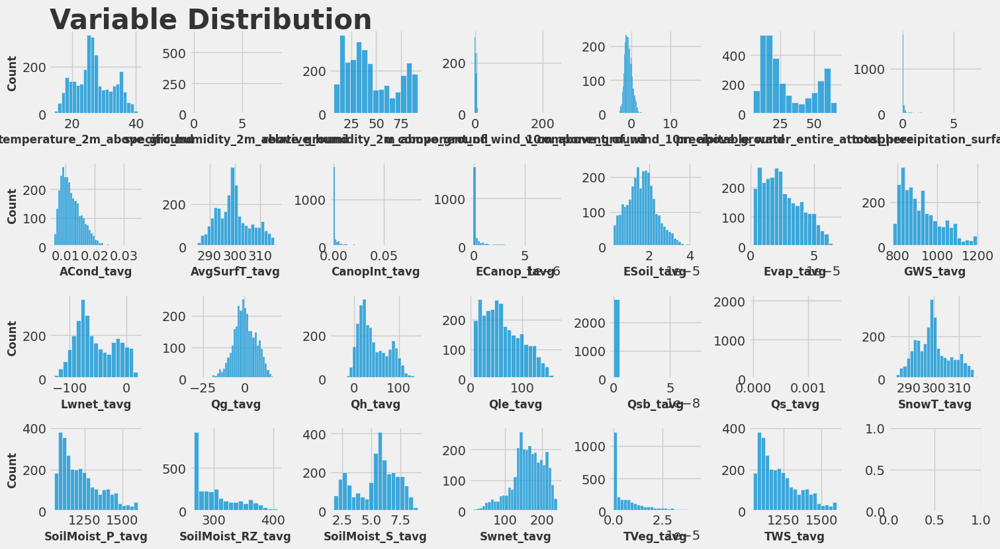

In [70]:
# Plot distribution of variables
r = 4
c = 7
fig, ax =  plt.subplots(r, c, figsize=(15, 8))
fig.tight_layout(h_pad=2.2)  
plt.text(x=0, y=1.3, s="Variable Distribution", ha='left', va='top', transform=ax[0, 0].transAxes, fontsize=30, fontweight='bold')
for i in range(len(cols)):
    if df[cols[i]].dtype == np.number:
        sns.histplot(df[cols[i]], ax=ax[i//c, i%c])
    else:
        sns.countplot(df[cols[i]], ax=ax[i//c, i%c])
    if i % c != 0:
        ax[i//c, i%c].set_ylabel("");

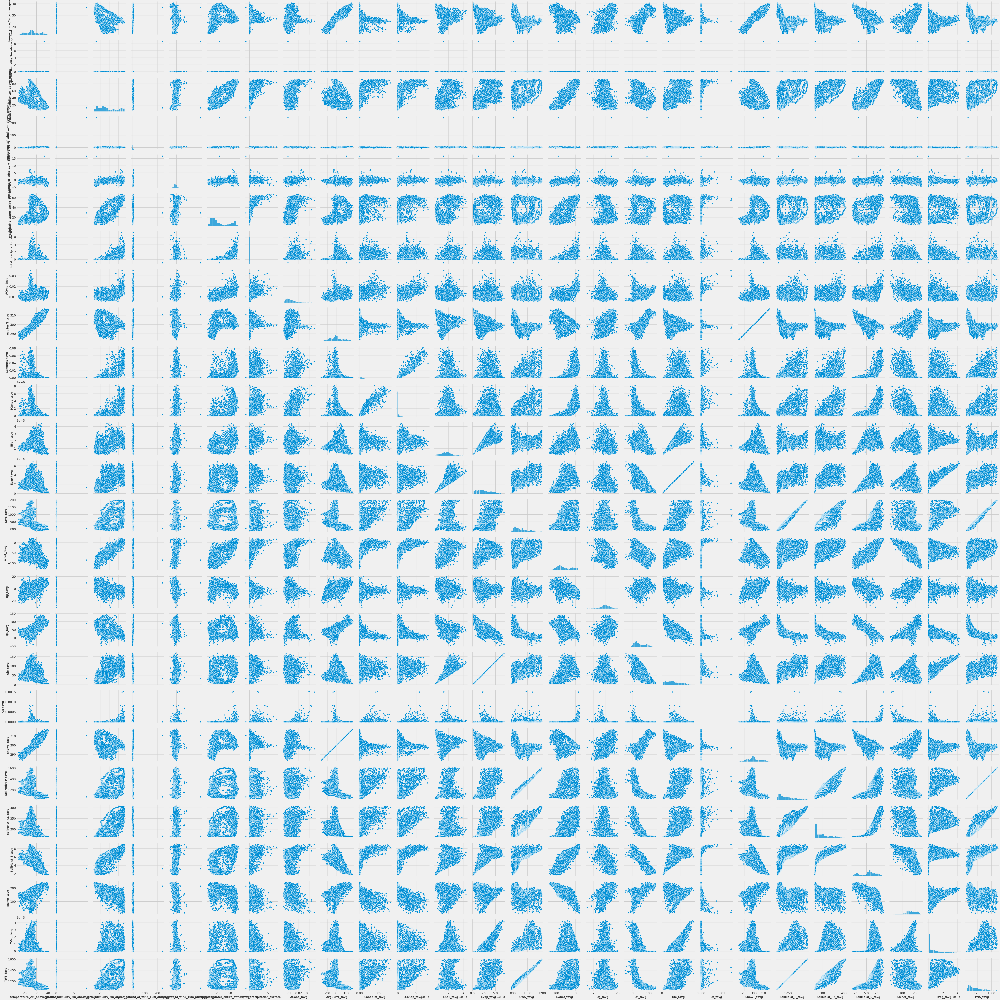

In [54]:
# Check distribution and bivariate
sns.pairplot(df);

# **Exploratory Data Analysis**

* Bhopal is the capital city of Madhya Pradesh state in central India. It lies on the Malwa Plateau, about 500 metres above sea level, and near the northern edge of the Vindhya Range. Bhopal has a mild climate with dry, hot summers and cool winters. Summer in Bhopal is late March through June followed by the monsoon or rainny season. Precipitation is concentrated during the monsoon season, which typically starts from late June to early October. Bhopal's annual rainfall is concentrated in the monsoon season.

* The precipitaion level in Bhopal is separated in 2 distinct wet and dry seasons. Precipitation level is close to zero from October through April. The rainfall volume is concentrated in the wet rainny season from May through the begining of October.

* The temperature and evapotranspiration reache to their peak in May, which is right before the monsoon season starts bringing annual rainfalls in the rigeon. This is critical to predict accurate precipitation along with temperature and evapotranspiration.

* The terrestrial water storage (TSW_tavg) should be our target variables 
* Features are classified in below 8 groups: aerodynamic conductance, temperature, heat, evapotranspiration, wind, humidity, moisture, precipitation, and water level.

* For conveniences, categorize each feature 
* **Aerodynamic conductance**
    * 'ACond_tavg'
* **temperature**
    * 'temperature_2m_above_ground'
    * 'AvgSurfT_tavg'
    * 'SnowT_tavg'
* **heat**
    * 'Lwnet_tavg' (Negative value)
    * 'Qg_tavg' (Small value)
    * 'Qh_tavg'
    * 'Qle_tavg'
* **Evapolation**
    * ECanop_tavg
    * ESoil_tavg (Small value)
    * Evap_tavg (Small value)
* **wind**
    * 'u_component_of_wind_10m_above_ground', 
    * 'v_component_of_wind_10m_above_ground'

* **Humidity**
    * 'specific_humidity_2m_above_ground', 
    * 'relative_humidity_2m_above_ground'
* **moisture**
    * 'SoilMoist_P_tavg', 
    * 'SoilMoist_RZ_tavg', 
    * 'SoilMoist_S_tavg'
* **precipitation**
    * 'precipitable_water_entire_atmosphere', 
    * 'total_precipitation_surface'

* **water**
    * CanopInt_tavg (Small value)
    * GWS_tavg
    * TWS_tavg

* **Univariate Analysis**
* Plots show seasonality, so statistical tests need to be conducted to check stationality
* 'TWS_tavg' has only one outlier value that is very close to the boder vlue, that means Bhopal has no exeptional terrestrial water volume during 2015 April 1 to 2023 June 30

In [75]:
# Assuming you have a DataFrame 'df'
fig = px.line(df, x="date", y=['GWS_tavg', 'TWS_tavg'], title='Daily Ground Water and Terrestrial Water Storage Trend')

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1200,
    height=400,)

fig.show(renderer="vscode")

In [76]:
# Check outliers
q1, q3  = np.quantile(df['TWS_tavg'], [0.25, 0.75])
iqr = q3 - q1
lower = q1 - iqr * 1.5
upper = q3 + iqr * 1.5
print(lower, upper)

idx = (df['TWS_tavg'] > upper) | (df['TWS_tavg'] < lower)
df.loc[idx, ['date', 'TWS_tavg']]


823.6560486041427 1599.6041818091544


,date,TWS_tavg
1629,2019-09-29,1601.950306


In [77]:
# Check moisture, humidity and water volume type features
fig = px.line(df, x="date", 
              y=['GWS_tavg', 'TWS_tavg', 'relative_humidity_2m_above_ground', 'SoilMoist_P_tavg', 'SoilMoist_RZ_tavg',], 
              labels=['Humidity 2M above ground', 'moisture in the upper 10cmsoil', 'moisture in the upper 2M soil'],
              title='Humidity 2M above Ground, Soil Moisture in the 10cm, 200cm on a Day (kmh)')

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1200,
    height=400,
)

fig.show(renderer="vscode")

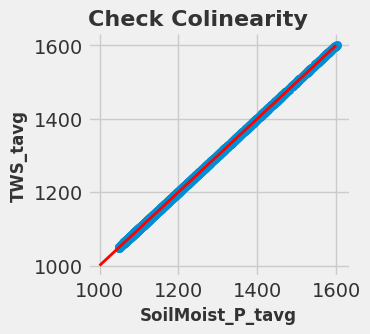

In [59]:
plt.figure(figsize=(3, 3))
plt.title("Check Colinearity")
plt.scatter(df['SoilMoist_P_tavg'], df['TWS_tavg'])
plt.plot([1000, 1600], [1000, 1600], c='r', lw=2)
plt.xlabel('SoilMoist_P_tavg')
plt.ylabel('TWS_tavg');

In [78]:
# Water volume related features
fig = px.line(df, x="date", y=['CanopInt_tavg', 'Qsb_tavg'], title='Daily Plant Canopy Surface Water Ground Water Runoff Trend')

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1200,
    height=400,)

fig.show(renderer="vscode")

* After converting from Kelvin to Celsius, the plot shows that 'temperature_2m_above_ground' and 'SnowT_celsius_tavg' and 'AvgSurfT' are almost identical

In [79]:
# Temperature related features
# Convert Kelvin to Celcius
df['SnowT_celsius_tavg'] = df['SnowT_tavg'] - 273.15 
df['AvgSurfT_celsius_tavg'] = df['AvgSurfT_tavg'] - 273.15
fig = px.line(df, x="date", y=['AvgSurfT_celsius_tavg', 'temperature_2m_above_ground', 'SnowT_celsius_tavg'], title='Mean Surface and Air Temperature at 2m above Ground (°C )')

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1200,
    height=400,
)

fig.show(renderer="vscode")

'Lwnet_tavg' and 'Qle_tavg' have the same pattern

In [61]:
# * **heat**
#     * 'Lwnet_tavg', 'Qg_tavg', 'Qh_tavg', 'Qle_tavg'
# * **Evapolation**
#     * ECanop_tavg

# Assuming you have a DataFrame 'df'
fig = px.line(df, x="date", 
              y=['Lwnet_tavg', 'Qg_tavg', 'Qh_tavg', 'Qle_tavg', 'ECanop_tavg'], 
              labels=['Humidity 2M above ground', 'moisture in the upper 10cmsoil', 'moisture in the upper 2M soil'],
              title='Net long-wave radiation, Heat, Sensible Heat Net, and Latent Heat Net Flux (W/m^2)')

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1200,
    height=400,
)

fig.show(renderer="vscode")

### **Feature Engineering**

In [80]:
# Create features
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['year_month'] = df['date'].dt.strftime('%Y_%m')
df['year_week'] = df['date'].dt.strftime('%Y_%U')
df['season'] = ['rainy season' if m in [5, 6, 7, 8, 9, 10] else 'dry season' for m in df['date'].dt.month]

In [81]:
df.sort_values('date').head()

,date,temperature_2m_above_ground,specific_humidity_2m_above_ground,relative_humidity_2m_above_ground,u_component_of_wind_10m_above_ground,v_component_of_wind_10m_above_ground,precipitable_water_entire_atmosphere,total_precipitation_surface,ACond_tavg,AvgSurfT_tavg,CanopInt_tavg,ECanop_tavg,ESoil_tavg,EvapSnow_tavg,Evap_tavg,GWS_tavg,Lwnet_tavg,Qg_tavg,Qh_tavg,Qle_tavg,Qsb_tavg,Qsm_tavg,Qs_tavg,SnowDepth_tavg,SnowT_tavg,SoilMoist_P_tavg,SoilMoist_RZ_tavg,SoilMoist_S_tavg,SWE_tavg,Swnet_tavg,TVeg_tavg,TWS_tavg,SnowT_celsius_tavg,AvgSurfT_celsius_tavg,year,month,year_month,year_week,season
0,2015-04-01,31.381519,0.005640,19.084161,4.671449,-0.277626,19.053919,0.0,0.009535,301.828791,0.000085,6.492022e-10,0.000028,0.0,0.000029,878.020093,-90.396704,5.002746,57.287802,70.673777,0.0,0.0,0.000000e+00,0.0,301.828791,1153.966420,275.946408,4.782809,0.0,223.362352,6.349899e-07,1153.966582,28.678791,28.678791,2015,4,2015_04,2015_13,dry season
1,2015-04-02,31.612318,0.006702,22.664057,5.663895,-0.951907,19.920647,0.0,0.011490,302.765242,0.000052,2.799420e-10,0.000028,0.0,0.000028,877.131936,-81.731904,9.743703,60.882683,69.560302,0.0,0.0,0.000000e+00,0.0,302.765242,1151.749923,274.617967,4.659694,0.0,221.923497,4.469356e-07,1151.749969,29.615242,29.615242,2015,4,2015_04,2015_13,dry season
2,2015-04-03,30.854070,0.006804,23.969701,5.704286,-0.857162,19.664423,0.0,0.012793,303.068777,0.000037,1.457972e-10,0.000026,0.0,0.000027,876.220241,-80.587193,6.332965,65.454717,65.798244,0.0,0.0,0.000000e+00,0.0,303.068777,1149.649158,273.428841,4.484641,0.0,218.171090,3.210499e-07,1149.649124,29.918777,29.918777,2015,4,2015_04,2015_13,dry season
3,2015-04-04,30.046127,0.008165,30.080859,2.575579,-1.547093,24.770628,0.0,0.014474,302.893081,0.000027,8.663470e-11,0.000021,0.0,0.000022,875.300761,-72.375750,7.162284,84.828026,53.421145,0.0,0.0,0.000000e+00,0.0,302.893081,1147.826225,272.525414,4.354961,0.0,217.789598,2.082960e-07,1147.826188,29.743081,29.743081,2015,4,2015_04,2015_13,dry season
4,2015-04-05,30.523074,0.007366,26.557658,-0.549178,-0.442961,23.765168,0.0,0.010641,302.875925,0.000883,2.446408e-07,0.000019,0.0,0.000019,874.372780,-56.206076,6.185620,66.643473,46.833714,0.0,0.0,1.183570e-09,0.0,302.875925,1146.413800,272.040991,4.340641,0.0,175.870913,1.475418e-07,1146.414677,29.725925,29.725925,2015,4,2015_04,2015_14,dry season


In [82]:
cols_to_plot = ['TWS_tavg', 'Swnet_tavg', 'AvgSurfT_tavg', 'relative_humidity_2m_above_ground', 'precipitable_water_entire_atmosphere']

In [83]:
# Mean by weekly, monthly, yearly
weekly_avg = df.groupby('year_week')[cols_to_plot].mean()

monthly_avg = df.groupby('year_month')[cols_to_plot].mean()

yearly_avg = df.groupby('year')[cols_to_plot].mean()

# Aggregated month total
monthly_terrestrial_water_sum = df.groupby('month')[['TWS_tavg', 'GWS_tavg']].agg(['mean', 'sum'])

yearly_terrestrial_water_sum = df.groupby('year')[['TWS_tavg', 'GWS_tavg']].sum()

seasonal_terrestrial_water_sum = df.groupby('season')[['TWS_tavg', 'GWS_tavg']].agg(['mean', 'sum'])

In [84]:
# Weekly average
subtitles = (cols_to_plot)
r = 1
c = 5
fig = make_subplots(rows=r, cols=c, subplot_titles=subtitles)

# Add traces
for i in range(len(cols_to_plot)):
    fig.add_trace(go.Scatter(x=weekly_avg.index, y=weekly_avg[cols_to_plot[i]], mode='lines'), row=r, col=i+1)

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1500,
    height=300,
)

fig.update_layout(title='<b>Weekly Average</b>', title_font=dict(size=24))

fig.show(renderer="vscode")

In [86]:
# Monthly average
subtitles = (cols_to_plot)
r = 1
c = 5
fig = make_subplots(rows=r, cols=c, subplot_titles=subtitles)

# Add traces
for i in range(len(cols_to_plot)):
    fig.add_trace(go.Scatter(x=monthly_avg.index, y=monthly_avg[cols_to_plot[i]], mode='lines'), row=r, col=i+1)

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1500,
    height=300,
)

fig.update_layout(title='<b>Monthly Average</b>', title_font=dict(size=24))

fig.show(renderer="vscode")

In [87]:
# Yearly average
r = 1
c = 5
fig = make_subplots(rows=r, cols=c, subplot_titles=subtitles)

# Add traces
for i in range(len(cols_to_plot)):
    fig.add_trace(go.Scatter(x=yearly_avg.index, y=yearly_avg[cols_to_plot[i]], mode='lines'), row=r, col=i+1)

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=1500,
    height=300,
)

fig.update_layout(title='<b>Yearly Average</b>', title_font=dict(size=24))

fig.show(renderer="vscode")

In [88]:
# Yearly total precipitation
fig = go.Figure(
    data=[go.Bar(x=yearly_terrestrial_water_sum.index, y=yearly_terrestrial_water_sum['TWS_tavg'])],
    layout_title_text="Terrestrial and Ground Water Storage Total by Year"
)

fig.add_trace(
    go.Bar(
        x=yearly_terrestrial_water_sum.index, 
        y=yearly_terrestrial_water_sum['GWS_tavg'],
        name='GWS_tavg'
    )
)
# Specify the figure size
fig.update_layout(
    autosize=False,
    width=600,
    height=300)

fig.show(width=600, height=300,renderer="vscode")

In [89]:
# Month total precipitation
fig = go.Figure(
    data=[go.Bar(x=monthly_terrestrial_water_sum.index, y=monthly_terrestrial_water_sum['TWS_tavg']['mean'].values)],
    layout_title_text="Average Terrestrial and Ground Water Storage by Month"
)

fig.add_trace(
    go.Bar(
        x=monthly_terrestrial_water_sum.index, 
        y=monthly_terrestrial_water_sum['GWS_tavg']['mean'],
        name='GWS_tavg'
    )
)

# Specify the figure size
fig.update_layout(
    autosize=False,
    width=600,
    height=300)

fig.show(width=600, height=300, renderer="vscode")

In [90]:
# Average precipitation by season
fig = go.Figure(
    data=[go.Bar(x=seasonal_terrestrial_water_sum.index, y=seasonal_terrestrial_water_sum['TWS_tavg']['mean'])],
    layout_title_text="Average Terrestrial and Ground Water Storage by Season"
)

fig.add_trace(
    go.Bar(
        x=seasonal_terrestrial_water_sum.index, 
        y=seasonal_terrestrial_water_sum['GWS_tavg']['mean'],
        name='GWS_tavg'
    )
)
# Specify the figure size
fig.update_layout(
    autosize=False,
    width=600,
    height=300)

fig.show(renderer="vscode")

# **Examine Correlation to 'TWS_tavg' and Colliniality between Other Features**

* 'EvapSnow_tavg', 'Qsm_tavg', 'SnowDepth_tavg', 'SWE_tavg' have all 0 values, however 'Qsb_tavg' has non 0 values and corration coefficient of 0.551502
* Thus, keep 'Qsb_tavg'
* Drop 'GWS_tavg', 'SnowT_tavg', 'Lwnet_tavg', 'Evap_tavg', 'SoilMoist_RZ_tavg', 'ECanop_tavg', 'AvgSurfT_tavg'

* These features have a correlation coefficient greater 0.9 
    * ('temperature_2m_above_ground', 'AvgSurfT_tavg')
    * ('temperature_2m_above_ground', 'SnowT_tavg'), 
    * ('relative_humidity_2m_above_ground', 'Lwnet_tavg'), 
    * ('AvgSurfT_tavg', 'SnowT_tavg'), 
    * ('CanopInt_tavg', 'ECanop_tavg'), 
    * ('Evap_tavg', 'Qle_tavg'), 
    * ('GWS_tavg', 'SoilMoist_P_tavg'), 
    * ('SoilMoist_P_tavg', 'SoilMoist_RZ_tavg')
* Drop one that has smaller coefficient: {'GWS_tavg', 'SnowT_tavg', 'Lwnet_tavg', 'Evap_tavg', 'SoilMoist_RZ_tavg', 'ECanop_tavg', 'AvgSurfT_tavg'}

* 'SoilMoist_P_tavg' and 'GWS_tavg' are almost perfectly correlated to 'TWS_tavg', thus they will be dropped

In [33]:
cols_with_small_values = ['ECanop_tavg', 'ESoil_tavg', 'Evap_tavg', 'EvapSnow_tavg', 'Qsb_tavg', 'Qsm_tavg', 'Qs_tavg', 'SnowDepth_tavg', 'SWE_tavg', 'TVeg_tavg']

corr_matrix = df.corr()
corr_matrix.loc['TWS_tavg', cols_with_small_values].sort_values()

Qs_tavg           0.160849
ESoil_tavg        0.367925
ECanop_tavg       0.534710
Qsb_tavg          0.551502
Evap_tavg         0.741507
TVeg_tavg         0.770409
EvapSnow_tavg          NaN
Qsm_tavg               NaN
SnowDepth_tavg         NaN
SWE_tavg               NaN
Name: TWS_tavg, dtype: float64

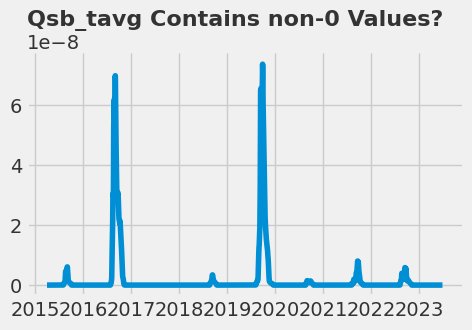

In [73]:
# Check 'Qsb_tavg' to see wheather values are all 0
plt.figure(figsize=(5, 3))
plt.title("Qsb_tavg Contains non-0 Values?")
plt.plot(df['date'], df['Qsb_tavg'])

<Axes: title={'left': 'Correlation Coefficient to TWS)tavg'}>

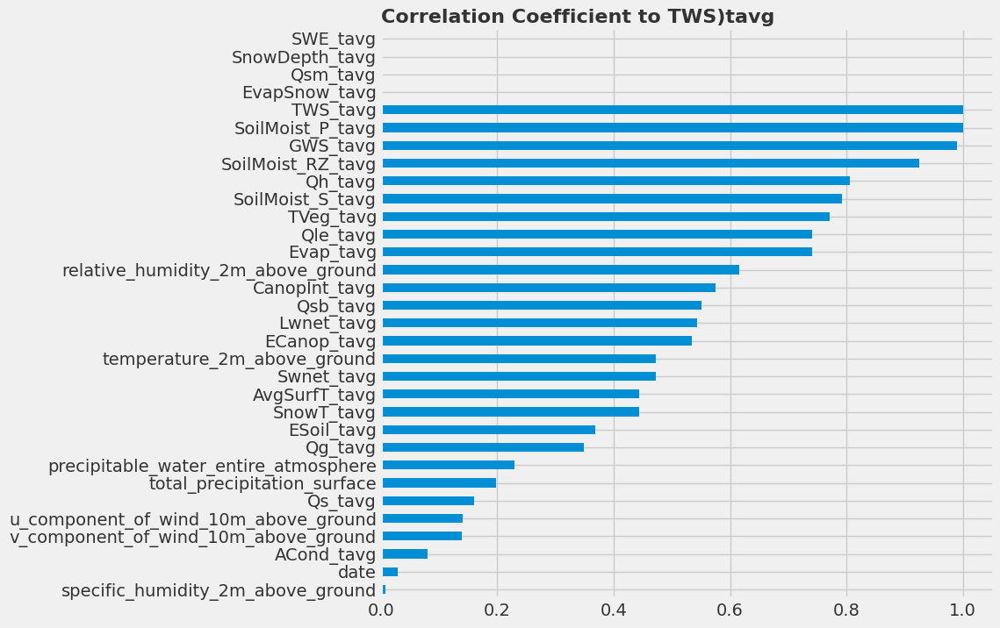

In [91]:
# Display correlation
plt.figure(figsize=(8, 8))
plt.title("Correlation Coefficient to TWS)tavg")
abs(corr_matrix['TWS_tavg']).sort_values().plot(kind='barh', );


In [68]:
# Get pairs where correlation is greater than 0.9
pairs = np.where(corr_matrix > 0.9)

# Get unique pairs
unique_pairs = [(pairs[0][i], pairs[1][i]) for i in range(len(pairs[0])) if pairs[0][i] < pairs[1][i]]

# Print column names for each pair
pairs = []
cols_to_drop = []
for pair in unique_pairs:
    # Check the correlation to TWS_tavg and put the larger feature first
    if (31 not in pair): # If the pair contains TWS_tavg, skip
        if (abs(corr_matrix.loc[corr_matrix.index[pair[0]], 'TWS_tavg']) > abs(corr_matrix.loc[corr_matrix.index[pair[1]], 'TWS_tavg'])):
            # print(f"Keep: {corr_matrix.columns[pair[0]]}, Delete: {corr_matrix.columns[pair[1]]}")
            cols_to_drop.append(corr_matrix.columns[pair[1]])
        else: 
            # print(f"Keep {corr_matrix.columns[pair[1]]}, Delete {corr_matrix.columns[pair[0]]}")
            cols_to_drop.append(corr_matrix.columns[pair[0]])
        pairs.append((corr_matrix.columns[pair[0]], corr_matrix.columns[pair[1]]))

print("Combination of features that has correlation coefficient greater than 0.9 ")
print(pairs)
print(f"Drop {set(cols_to_drop)}")

Combination of features that has correlation coefficient greater than 0.9 
[('temperature_2m_above_ground', 'AvgSurfT_tavg'), ('temperature_2m_above_ground', 'SnowT_tavg'), ('relative_humidity_2m_above_ground', 'Lwnet_tavg'), ('AvgSurfT_tavg', 'SnowT_tavg'), ('CanopInt_tavg', 'ECanop_tavg'), ('Evap_tavg', 'Qle_tavg'), ('GWS_tavg', 'SoilMoist_P_tavg'), ('SoilMoist_P_tavg', 'SoilMoist_RZ_tavg')]
Drop {'GWS_tavg', 'SnowT_tavg', 'Lwnet_tavg', 'Evap_tavg', 'SoilMoist_RZ_tavg', 'ECanop_tavg', 'AvgSurfT_tavg'}


In [92]:
# Drop columns that have colliniality to another columns and all 0 value columns
cols_to_drop = list(cols_to_drop) + ['EvapSnow_tavg', 'Qsm_tavg', 'SnowDepth_tavg', 'SWE_tavg'] + ['SoilMoist_P_tavg']
df.drop(cols_to_drop, inplace=True, axis=1)

In [98]:
df['season'] = df['season'].map({'dry season': 0, 'rainy season': 1})

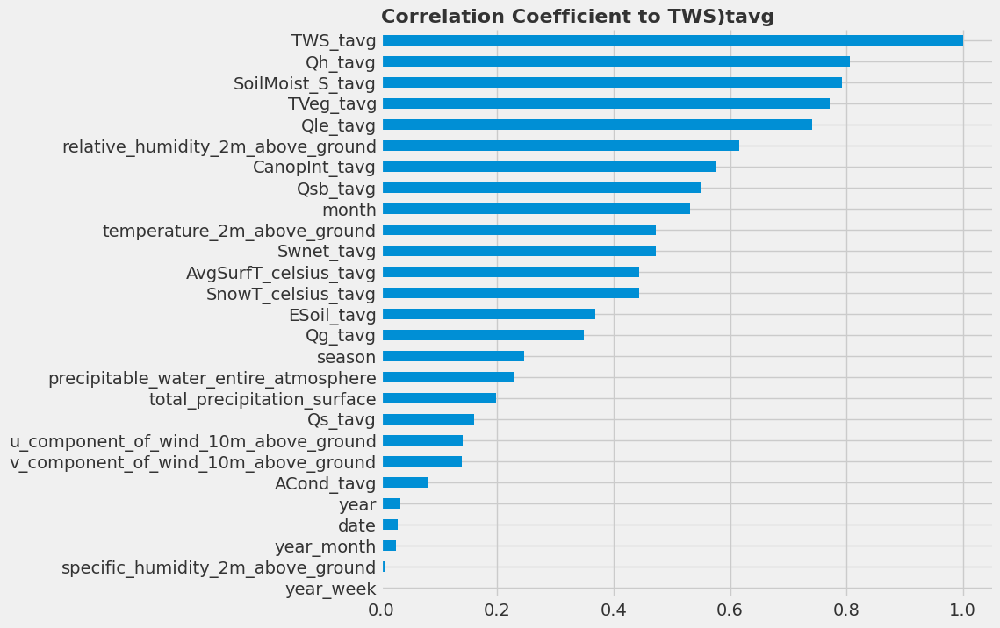

In [101]:
# Display correlation
corr_matrix = df.corr()
plt.figure(figsize=(8, 8))
plt.title("Correlation Coefficient to TWS)tavg")
abs(corr_matrix['TWS_tavg']).sort_values().plot(kind='barh', );

# **Statistical Tests**
* Some time series algorighms such as ARIMA, SARIMA, or VAR require the series to be stational
* Our data shows distinctive seasonal pattern, thus it needs to check the stationality
* We will check stationality using both visual and statistical test
* Even the plot shows the seasonality, it looks consistent, thus 'precipitation_sum' is detected as stational
## **Seasonal Decomposition Plot**
## **Augmented Dickey_Fuller Test**
* The ADF test was conducted to all 5 features.
* The p-value of the test result against 'temperature_2m_mean' was greater than 0.05, thus 'temperature_2m_mean' was not statinal
* 'precipitation_sum', 'wind_speed_10m_max', 'wind_direction_10m_dominant', and 'et0_fao_evapotranspiration' were stational
    * Null Hypothesis: 'precipitation_sum' is not stational
    * Alternative Hypothesis: 'precipitation_sum' is stational
## **Grander's Causality Test**
* Grander's Causality Tests is used to determine whether one time series is causal to another time series
* Granger's Causality test results indicate the causality relation exists shown as below:
* wind_speed_10m_max --> temperature_2m_mean, precipitation_sum
* wind_direction_10m_dominant --> precipitation_sum, wind_speed_10m_max
* et0_fao_evapotranspiration --> wind_speed_10m_max, wind_direction_10m_dominant, precipitation_sum
    * Null Hypothesis: col1 DOES NOT explain the variation in col2
    * Alternative Hypothesis: col1 DOES explain the variation in col2

In [103]:
df.set_index('date', inplace=True)

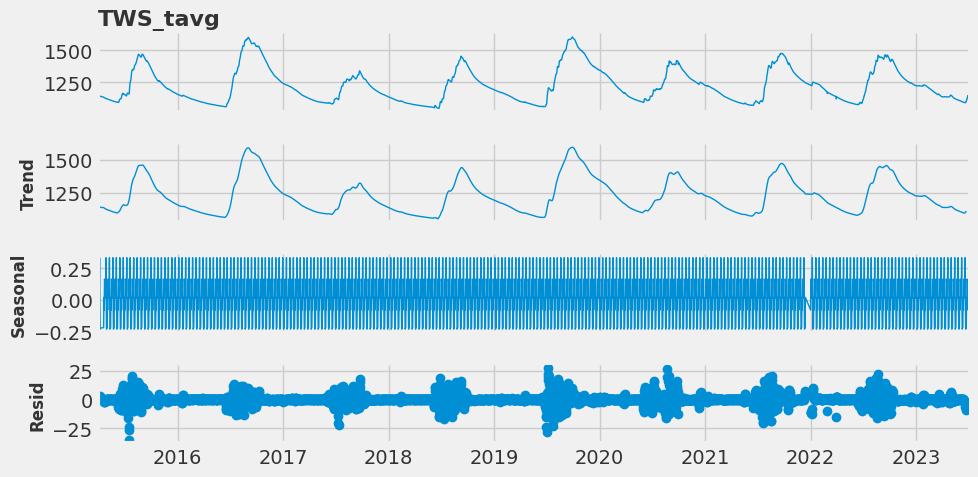

In [104]:
# Seasonal decomposition plot
decomposition = sm.tsa.seasonal_decompose(df['TWS_tavg'], model='additive', period=12)
# Change the line width
fig = decomposition.plot()
for ax in fig.axes:
    for line in ax.get_lines():
        line.set_linewidth(1)

## **Augumented Dickey Fuller Test**
* The test result indicates all features are stationary

In [113]:
# Function to print the ADF result
def adf(df, col):
    # Conduct Augmented Dickey_Fuller Test
    adf_result = adfuller(df[col])
    # Print the ADF test results
    print(f"------- {col} -------")
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: : {adf_result[1]}")
    print('Critical Values:')
    for key, value in adf_result[4].items():
        print(f"\t{key}: {value}")

    if adf_result[1] <= 0.05:
        print("The series is stationary")
    else:
        print("The series is NOT stationary")
    print()

In [114]:
# Run the ADF test for all features
cols_to_test = [c for c in df.columns if c not in ['year', 'month', 'year_month', 'year_week', 'season']]
for col in cols_to_test:
    adf(df, col)

------- temperature_2m_above_ground -------
ADF Statistic: -5.505900958427408
p-value: : 2.0222557999895115e-06
Critical Values:
	1%: -3.43256789134622
	5%: -2.8625199184567043
	10%: -2.5672916373706265
The series is stationary

------- specific_humidity_2m_above_ground -------
ADF Statistic: -54.54783984675619
p-value: : 0.0
Critical Values:
	1%: -3.432547027098869
	5%: -2.8625107035227066
	10%: -2.5672867314313095
The series is stationary

------- relative_humidity_2m_above_ground -------
ADF Statistic: -5.289263306998628
p-value: : 5.763137925049845e-06
Critical Values:
	1%: -3.43256789134622
	5%: -2.8625199184567043
	10%: -2.5672916373706265
The series is stationary

------- u_component_of_wind_10m_above_ground -------
ADF Statistic: -5.023400460655467
p-value: : 1.99443258161217e-05
Critical Values:
	1%: -3.432561889805549
	5%: -2.862517267814074
	10%: -2.5672902261937134
The series is stationary

------- v_component_of_wind_10m_above_ground -------
ADF Statistic: -6.5347870450389

## **Granger Causality Test**
* Check a variable is causal to the other variable
* Granger's Causality test results indicate the causality relation exists shown as below:
     * 'temperature_2m_above_ground',
     * 'relative_humidity_2m_above_ground',
     * 'u_component_of_wind_10m_above_ground',
     * 'precipitable_water_entire_atmosphere',
     * 'CanopInt_tavg',
     * 'ESoil_tavg',
     * 'Qg_tavg',
     * 'Qh_tavg',
     * 'Qle_tavg',
     * 'Qs_tavg',
     * 'Swnet_tavg',
     * 'TVeg_tavg'

In [138]:
cols_causality = []
for i in range(len(cols_to_test) - 1):
    for j in range(i + 1, len(cols_to_test)):
        granger_test_result = grangercausalitytests(df[[cols_to_test[i], cols_to_test[j]]], maxlag=1, verbose=False)
        p_value = granger_test_result[1][0]['params_ftest'][1]
        if (p_value < 0.05) & (cols_to_test[j] == 'TWS_tavg'):
            # granger(df[cols[i]], df[cols[j]])
            print(f"Testing causality for: {cols_to_test[i]} -> {cols_to_test[j]}")
            cols_causality.append(cols_to_test[i])

Testing causality for: temperature_2m_above_ground -> TWS_tavg
Testing causality for: relative_humidity_2m_above_ground -> TWS_tavg
Testing causality for: u_component_of_wind_10m_above_ground -> TWS_tavg
Testing causality for: precipitable_water_entire_atmosphere -> TWS_tavg
Testing causality for: CanopInt_tavg -> TWS_tavg
Testing causality for: ESoil_tavg -> TWS_tavg
Testing causality for: Qg_tavg -> TWS_tavg
Testing causality for: Qh_tavg -> TWS_tavg
Testing causality for: Qle_tavg -> TWS_tavg
Testing causality for: Qs_tavg -> TWS_tavg
Testing causality for: Swnet_tavg -> TWS_tavg
Testing causality for: TVeg_tavg -> TWS_tavg


In [143]:
print("--- These columns have causality relation to 'TWS_tavg' ---")
for feature in cols_causality:
    print(f"\t{feature}")

--- These columns have causality relation to 'TWS_tavg' ---
	temperature_2m_above_ground
	relative_humidity_2m_above_ground
	u_component_of_wind_10m_above_ground
	precipitable_water_entire_atmosphere
	CanopInt_tavg
	ESoil_tavg
	Qg_tavg
	Qh_tavg
	Qle_tavg
	Qs_tavg
	Swnet_tavg
	TVeg_tavg


# **Insights**
* 'TWS_tavg' is the most suitable target variable for water management analysis in the dataset.
* 'Qh_tavg', 'SoilMoist_S_tavg', 'TVeg_tavg', 'relative_humidity_2m_above_ground', 'CanopInt_tavg', 'Qsv_tavg', and 'month' have correlation coefficients greater than 0.5.
* Notably, 'Qh_tavg', 'SoilMoist_S_tavg', and 'TVeg_tavg' have correlation coefficients greater than or very close to 0.8.
* The ADF test indicates that all features in the dataset are stationary, which is an assumption of many time series algorithms.
* Therefore, no variable transformation or lagging is necessary for ARIMA, SARIMA, or VAR.

* Granger's Causality test results indicate the causality relation to 'TWS_tavg' exists shown as below:
     * 'temperature_2m_above_ground',
     * 'relative_humidity_2m_above_ground',
     * 'u_component_of_wind_10m_above_ground',
     * 'precipitable_water_entire_atmosphere',
     * 'CanopInt_tavg',
     * 'ESoil_tavg',
     * 'Qg_tavg',
     * 'Qh_tavg',
     * 'Qle_tavg',
     * 'Qs_tavg',
     * 'Swnet_tavg',
     * 'TVeg_tavg'

* The analysis of the bhopal_nat_metrics.csv dataset (refer to EDA_Bhopal_Weather_MihoRosenberg.jpynb) reveals a significant disparity in monthly and seasonal precipitation levels, but not as much variation in terrestrial water storage. It is noteworthy that the water bodies are retained without being significantly affected by precipitation.